# Week 4 

How to extract data in from netcdf files in a reproducible manner.

To do this we are going to use a GeoDatframe that defines the extents (lon/lat) of the desired region(s). This GeoDataFrame can be created manually from coords, imported from a shapefile or other or be created interactively using Bokeh for example. In this notebook we will look at the first two cases.

## Wrokflow

1. Import netcdf
1. Import Spatial data
1. Rasterize spatial data onto a rectilinear grid
1. Inteprolate data from base grid to netcdf grid (this can be done in the rasterize step if both are rectilinear)
1. Add spatial data to grid
1. Use groupby to carry out opperations on a basin by basin basis

In [1]:
from shapely.geometry import Polygon # Used to build polygons manually
import geopandas as gpd # Used to stock geospatial data and load geospatial data
import xarray as xr # Netcdf
import numpy # basic array operations
# Rasterizing tools
from affine import Affine 
from rasterio import features

# Visualization
import hvplot.pandas
import hvplot.xarray

import bokeh
import panel as pn

We can manually create a polygon from coordinates like so

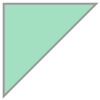

In [2]:
Polygon([(0, 0), (1, 1), (0, 1)])

We can store multiple polygons and data associated inside a geodataframe

In [3]:
df = gpd.GeoDataFrame(
    [
        [1, Polygon([(0, 0), (1, 1), (0, 1)])],
        [10, Polygon([(0, 0), (-5, -5), (0, -5)])],
    ],
    columns=["Some Data", "geometry"]
)
df

,Some Data,geometry
0,1,"POLYGON ((0.00000 0.00000, 1.00000 1.00000, 0...."
1,10,"POLYGON ((0.00000 0.00000, -5.00000 -5.00000, ..."


We can view those polygons on a map bby specifying 'tiles=' and `geo=True` to specify that the geometry is in longitude and latitude

In [4]:
bokeh.io.output_notebook()
df.hvplot(tiles='ESRI', geo=True)

Loading BokehJS ...

:Overlay
   .Tiles.I    :Tiles   [x,y]
   .Polygons.I :Polygons   [Longitude,Latitude]

## Load shapefile

Geopandas also allows us to load a shapefile, this can be generated in software like ARCGIS or QGIS or saved manually from the previous dataframe.

The benefits of saving the polygons in a shapefile means that they can be reused in different scripts and different runs, compared to an interactive tool where you would have to reselect data each time the notebook is run

In [5]:
df = gpd.read_file('/home/wbanfield/GEN2212/GEN2212.wbanfield/Snakes_in_space/04/basins.shp')
df

,TocMax,geometry
0,25.0,"POLYGON ((-22.99179 20.45205, -18.73606 28.770..."
1,10.0,"POLYGON ((-7.36298 -10.05285, -0.37315 -3.8853..."
2,13.0,"POLYGON ((10.93394 -38.83452, 12.37302 -28.966..."
3,46.0,"POLYGON ((-57.73091 -41.09594, -40.25632 -35.5..."
4,55.0,"POLYGON ((-28.12691 -21.15435, -21.13707 -14.1..."
5,67.0,"POLYGON ((-6.54065 -35.54519, 4.14968 -40.8903..."


Similarly you can view the new dataframe

In [6]:
bokeh.io.output_notebook()
df.hvplot(color='TocMax',geo=True, tiles='ESRI', cmap='RdBu', alpha=0.75)

Loading BokehJS ...

:Overlay
   .Tiles.I    :Tiles   [x,y]
   .Polygons.I :Polygons   [Longitude,Latitude]   (TocMax)

## Load NetCDF

Here we load the netcdf classically. Note the presence of nav_lat and nav_lon

In [7]:
ds = xr.open_dataset('~/GEN2212/GEN2212.asarr/PISCES_notebook/PIS-90-PD-DustCret_SE_9755_9854_1M_ptrc_T.nc')
ds

<xarray.Dataset>
Dimensions:               (axis_nbounds: 2, nvertex: 4, olevel: 31, tbnds: 2, time_counter: 12, x: 182, y: 149)
Coordinates:
  * time_counter          (time_counter) object 0000-01-16 00:00:00 ... 0000-...
    nav_lat               (y, x) float32 ...
    nav_lon               (y, x) float32 ...
  * olevel                (olevel) float32 5.0 15.0 25.0 ... 4.75e+03 5.25e+03
    time_centered         (time_counter) object ...
Dimensions without coordinates: axis_nbounds, nvertex, tbnds, x, y
Data variables:
    time_counter_bnds     (time_counter, tbnds) object ...
    bounds_nav_lon        (y, x, nvertex) float32 ...
    bounds_nav_lat        (y, x, nvertex) float32 ...
    area                  (y, x) float32 ...
    olevel_bounds         (olevel, axis_nbounds) float32 ...
    time_centered_bounds  (time_counter, axis_nbounds) object ...
    time_counter_bounds   (time_counter, axis_nbounds) float64 ...
    DIC                   (time_counter, olevel, y, x) float32 ...
    Alkalini              (time_counter, olevel, y, x) float32 ...
    O2                    (time_counter, olevel, y, x) float32 ...
    CaCO3                 (time_counter, olevel, y, x) float32 ...
    PO4                   (time_counter, olevel, y, x) float32 ...
    POC                   (time_counter, olevel, y, x) float32 ...
    Si                    (time_counter, olevel, y, x) float32 ...
    PHY                   (time_counter, olevel, y, x) float32 ...
    ZOO                   (time_counter, olevel, y, x) float32 ...
    DOC                   (time_counter, olevel, y, x) float32 ...
    PHY2                  (time_counter, olevel, y, x) float32 ...
    ZOO2                  (time_counter, olevel, y, x) float32 ...
    DSi                   (time_counter, olevel, y, x) float32 ...
    Fer                   (time_counter, olevel, y, x) float32 ...
    BFe                   (time_counter, olevel, y, x) float32 ...
    GOC                   (time_counter, olevel, y, x) float32 ...
    SFe                   (time_counter, olevel, y, x) float32 ...
    DFe                   (time_counter, olevel, y, x) float32 ...
    GSi                   (time_counter, olevel, y, x) float32 ...
    NFe                   (time_counter, olevel, y, x) float32 ...
    NCHL                  (time_counter, olevel, y, x) float32 ...
    DCHL                  (time_counter, olevel, y, x) float32 ...
    NO3                   (time_counter, olevel, y, x) float32 ...
    NH4                   (time_counter, olevel, y, x) float32 ...
Attributes:
    name:                      PIS-90-PD-DustCret_1m_ptrc_T
    description:               pisces sms variables
    title:                     pisces sms variables
    Conventions:               CF-1.6
    timeStamp:                 2021-Feb-15 19:57:29 GMT
    uuid:                      7156f8ba-7d10-4152-b3e7-41852c1b51b0
    history:                   Tue Feb 16 04:11:15 2021: ncrcat -C --buffer_s...
    NCO:                       "4.6.0"
    nco_openmp_thread_number:  1

We can view the netcdf file using a quadmesh because of the curvilinear coordinates.

- using `rasterize=True` means that the actual grid isnt sent back but a projection of the grid onto a standard grid is shown, this speeds up manipulation of the graph greatly
- `project=True` and `geo=True` tells holoviews to project the data once to a geographic coordinates at the start rather than doing it on each refresh

In [8]:
bokeh.io.output_notebook()
pn.Pane(ds.O2.hvplot.quadmesh(x='nav_lon', y='nav_lat', project=True, geo=True, rasterize=True, cmap='RdBu'))

Loading BokehJS ...

HoloViews(DynamicMap)

Using the `*` operator we can overlay the basins on the xarray data

In [9]:
bokeh.io.output_notebook()
ds.O2.hvplot.quadmesh(x='nav_lon', y='nav_lat', project=True, geo=True, rasterize=True, cmap='RdBu') * df.hvplot(geo=True, alpha=0.5)

Loading BokehJS ...

:DynamicMap   [olevel,time_counter]
   :Overlay
      .Image.I    :Image   [nav_lon,nav_lat]   (O2)
      .Polygons.I :Polygons   [Longitude,Latitude]

Here we define a function that accepts shapes (polygones) and rasterizes them into rectilinear xarray objects

In [10]:
import numpy as np
def transform_from_latlon(lat, lon):
    lat = np.asarray(lat)
    lon = np.asarray(lon)
    trans = Affine.translation(lon[0], lat[0])
    scale = Affine.scale(lon[1] - lon[0], lat[1] - lat[0])
    return trans * scale

def rasterize(shapes, fill=np.nan, **kwargs):
    """Rasterize a list of (geometry, fill_value) tuples onto the given
    xray coordinates. This only works for 1d latitude and longitude
    arrays.
    """
    coords = {
        'latitude': numpy.arange(-90, 90, 0.2),
        'longitude': numpy.arange(-180, 180, 0.2)
    }
    transform = transform_from_latlon(coords['latitude'], coords['longitude'])
    out_shape = (len(coords['latitude']), len(coords['longitude']))
    raster = features.rasterize(shapes, out_shape=out_shape,
                                fill=fill, transform=transform,
                                dtype=float, **kwargs)
    return xr.DataArray(raster, coords=coords, dims=('latitude', 'longitude'))

In [11]:
shapes = [(shape, n) for n, shape in enumerate(df.geometry)]
shapes

[(<shapely.geometry.polygon.Polygon at 0x7f50cb040e50>, 0),
 (<shapely.geometry.polygon.Polygon at 0x7f50cb040a10>, 1),
 (<shapely.geometry.polygon.Polygon at 0x7f50cb040f90>, 2),
 (<shapely.geometry.polygon.Polygon at 0x7f50cb040ad0>, 3),
 (<shapely.geometry.polygon.Polygon at 0x7f50cb0d7b10>, 4),
 (<shapely.geometry.polygon.Polygon at 0x7f50cb0d7690>, 5)]

See how now we are rasterized and in xarray

In [12]:
basins_xr = rasterize(shapes)

bokeh.io.output_notebook()
basins_xr.hvplot()

Loading BokehJS ...

:Image   [longitude,latitude]   (value)

## Reproject to curvilinear

Here we reproject the coordinates using the cooridnates found in the input netcdf file. We tell the interpolation to map 'latitude' to 'nav_lat' ....

In [13]:
basins_xr_curvi = basins_xr.interp({'latitude': ds.nav_lat, 'longitude': ds.nav_lon}, method="nearest")

bokeh.io.output_notebook()
basins_xr_curvi.hvplot.quadmesh(x='nav_lon', y='nav_lat')

Loading BokehJS ...

:QuadMesh   [nav_lon,nav_lat]   (value)

Now that both xarrays have the same coordinates we can add the basins to the input netcdf

In [14]:
ds['basins'] = basins_xr_curvi

In [15]:
bokeh.io.output_notebook()
ds.basins.hvplot.quadmesh()

Loading BokehJS ...

:QuadMesh   [longitude,latitude]   (basins)

## Calculations

Now all the data is in the same place we can start running some calculations on each basin

xarray proposes the groupby which will split my xarray into multiple xarrays according to groups.

Below we create one group per basin

<div class="alert alert-info">
     For continous varaibles there is a bins keyword
</div>

In [16]:
groups = ds.groupby('basins')
groups

DatasetGroupBy, grouped over 'basins' 
6 groups with labels 0.0, 1.0, 2.0, 3.0, 4.0, 5.0.

Lets calculate the mean O2 value per basin per time_step and per level

In [19]:
bokeh.io.output_notebook()
groups.mean().O2.hvplot.scatter()

Loading BokehJS ...

:DynamicMap   [olevel,basins]
   :Scatter   [time_centered]   (O2)

We can also calculate the mean O2 over all time steps per basins as so

In [20]:
groups.mean('time_counter').O2

<xarray.DataArray 'O2' (olevel: 31, y: 76, x: 47)>
array([[[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
...
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]], dtype=float32)
Coordinates:
    nav_lat    (y, x) float32 nan nan nan nan nan nan ... nan nan nan nan nan
    nav_lon    (y, x) float32 nan nan nan nan nan nan ... nan nan nan nan nan
  * olevel     (olevel) float32 5.0 15.0 25.0 ... 4.25e+03 4.75e+03 5.25e+03
    latitude   (y, x) float32 nan nan nan nan nan nan ... nan nan nan nan nan
    longitude  (y, x) float32 nan nan nan nan nan nan ... nan nan nan nan nan
Dimensions without coordinates: y, x

# Extra get sea floor values
The following bit of code looks for the first null value down the olevels -> sea bed, takes the block just above it -> last defined value and extracts this at each loaction

this means that we can calucate the values on the seabed

In [22]:
bokeh.io.output_notebook()
ds['O2'][:, ds['O2'].isnull().argmax('olevel') - 1].hvplot.quadmesh(geo=True, rasterize=False)

Loading BokehJS ...

:DynamicMap   [time_counter]
   :QuadMesh   [longitude,latitude]   (O2)

Running this at the top of the notebook will replace all variables with their value on the sea bed

In [ ]:
# This can take a while because we are doing the calculation for every variable we could maybe filter things out here
for var in ds.data_vars:
    if 'olevel' in ds[var].coords:
        # Find where values are null
        # Argmax is going to give use the first null encountered (in depth)
        # We remove 1 olevel to get the last non null value
        ds[var] = ds[var][ds[var].isnull().argmax('olevel') - 1]